In [1]:
from read_xgaze import read_xml, read_csv_as_dict, read_lm_gc, draw_lm
import cv2
from normalize_data import read_image, normalize, estimateHeadPose
import numpy as np
from PIL import Image, ImageDraw

In [2]:
def draw_lm(image, landmarks, color= (0, 0, 255),  print_idx=False):
	i = 0
	for x,y in landmarks:
		# Radius of circle
		radius = 20
		# Line thickness of 2 px
		thickness = -1
		image = cv2.circle(image, (int(x), int(y)), radius, color, thickness)
		if print_idx:
			image = cv2.putText(image,
				text=str(i),
				org=(int(x), int(y)),
				fontFace=cv2.FONT_HERSHEY_SIMPLEX,
				fontScale=2.0,
				color=color,
				thickness=2,
				lineType=cv2.LINE_4)
		
		i += 1
	return image

In [3]:
import os
from matplotlib import pyplot as plt

base_dir = '/home/s-uesaka/datasets/xgazeraw'
raw_path = os.path.join(base_dir, 'data/train') 
calibration_path = os.path.join(base_dir, 'calibration/cam_calibration') 
annatation_path = os.path.join(base_dir, 'data/annotation_train')  



input_path='/home/s-uesaka/datasets/xgazeraw/data/train/subject0000/frame0001/cam00.JPG'
img_name = os.path.basename(input_path)
frame = input_path.split('/')[-2]
subject = input_path.split('/')[-3]
csv_path = os.path.join(annatation_path, subject+'.csv') 
sub_dict = read_csv_as_dict(csv_path)

In [4]:
img_path = os.path.join(raw_path, subject, frame, img_name)
img = Image.open(img_path)

In [5]:
img_size = img.size
img_size

(6000, 4000)

In [6]:
lm_gt, gc, _, _ = read_lm_gc(sub_dict, os.path.join(frame,img_name))

In [7]:
nose = np.mean(lm_gt[27:31], axis=0).astype(int)
nose

array([2998, 1839])

In [8]:
lm_gt[27:31]

array([[3040, 1608],
       [3008, 1780],
       [2972, 1916],
       [2972, 2052]])

In [9]:
left_eye = np.mean(lm_gt[36:42], axis=0).astype(int)

In [56]:
left_eye

array([2596, 1674])

In [57]:
right_eye = np.mean(lm_gt[42:48], axis=0).astype(int)

In [58]:
right_eye

array([3524, 1674])

In [59]:
face_center = sum([nose,right_eye,left_eye])//3

In [60]:
face_center


array([3039, 1729])

In [61]:
def crop_center(pil_img, center, crop_width, crop_height):
    crop_width_half_1 = crop_width // 2
    crop_width_half_2 = crop_width - crop_width_half_1
    crop_height_half_1 = crop_height // 2
    crop_height_half_2 = crop_height - crop_height_half_1
    upper_left_x = center[0] - crop_width_half_1
    upper_left_y = center[1] - crop_height_half_1
    
    return [upper_left_x, upper_left_y], pil_img.crop(((center[0] - crop_width_half_1),
                         (center[1] - crop_height_half_1),
                         (center[0] + crop_width_half_2),
                         (center[1] + crop_height_half_2)))

In [206]:
crop_size = (2700,2700)
upper_left, cropped = crop_center(img, face_center, crop_size[0], crop_size[1])

In [63]:
lm_gt_cropped = lm_gt - upper_left

In [75]:
img_size_cropped = cropped.size

In [ ]:
img_resize = cropped.resize((768, 768))
img_size_resized = img_resize.size

In [70]:
np.array(img_size_resized)/np.array(img_size)

array([0.128, 0.192])

In [74]:
len(lm_gt_resized)

68

In [76]:
lm_gt_resized = lm_gt_cropped*np.array(img_size_resized)/np.array(img_size_cropped)

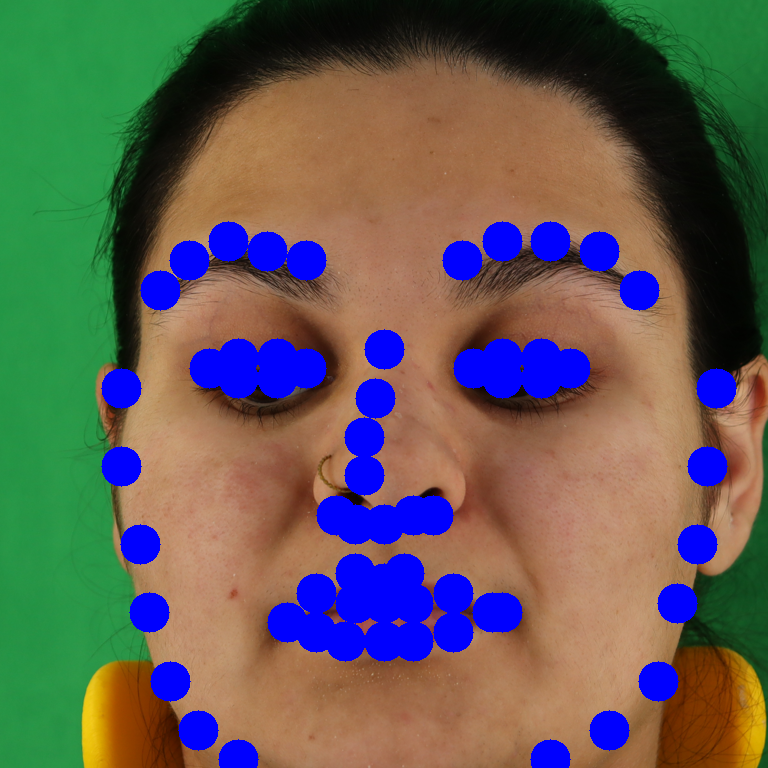

In [77]:
image_with_points = draw_lm(np.array(img_resize),lm_gt_resized)
Image.fromarray(image_with_points)

In [68]:
import sys
import torch
import numpy as np
from PIL import Image
from omegaconf import OmegaConf
from einops import repeat, rearrange
from pytorch_lightning import seed_everything
from imwatermark import WatermarkEncoder

from scripts.txt2img import put_watermark
from ldm.util import instantiate_from_config
from ldm.models.diffusion.ddim import DDIMSampler
from ldm.data.util import AddMiDaS

torch.set_grad_enabled(False)

In [162]:
def initialize_model(config, ckpt):
    config = OmegaConf.load(config)
    model = instantiate_from_config(config.model)
    model.load_state_dict(torch.load(ckpt)["state_dict"], strict=False)

    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    model = model.to(device)
    sampler = DDIMSampler(model)
    return sampler


def make_batch_sd(
        image,
        txt,
        device,
        num_samples=1,
        model_type="dpt_hybrid"
):
    image = np.array(image.convert("RGB"))
    image = torch.from_numpy(image).to(dtype=torch.float32) / 127.5 - 1.0
    # sample['jpg'] is tensor hwc in [-1, 1] at this point
    midas_trafo = AddMiDaS(model_type=model_type)
    batch = {
        "jpg": image,
        "txt": num_samples * [txt],
    }
    batch = midas_trafo(batch)
    batch["jpg"] = rearrange(batch["jpg"], 'h w c -> 1 c h w')
    batch["jpg"] = repeat(batch["jpg"].to(device=device), "1 ... -> n ...", n=num_samples)
    batch["midas_in"] = repeat(torch.from_numpy(batch["midas_in"][None, ...]).to(device=device), "1 ... -> n ...", n=num_samples)
    return batch


def paint(sampler, image, prompt, t_enc, seed, scale, num_samples=1, callback=None,
          do_full_sample=False):
    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    model = sampler.model
    seed_everything(seed)

    print("Creating invisible watermark encoder (see https://github.com/ShieldMnt/invisible-watermark)...")
    wm = "SDV2"
    wm_encoder = WatermarkEncoder()
    wm_encoder.set_watermark('bytes', wm.encode('utf-8'))

    with torch.no_grad(),\
            torch.autocast("cuda"):
        batch = make_batch_sd(image, txt=prompt, device=device, num_samples=num_samples)
        z = model.get_first_stage_encoding(model.encode_first_stage(batch[model.first_stage_key]))  # move to latent space
        c = model.cond_stage_model.encode(batch["txt"])
        c_cat = list()
        for ck in model.concat_keys:
            cc = batch[ck]
            cc = model.depth_model(cc)
            depth_min, depth_max = torch.amin(cc, dim=[1, 2, 3], keepdim=True), torch.amax(cc, dim=[1, 2, 3],
                                                                                           keepdim=True)
            display_depth = (cc - depth_min) / (depth_max - depth_min)
            #st.image(Image.fromarray((display_depth[0, 0, ...].cpu().numpy() * 255.).astype(np.uint8)))
            cc = torch.nn.functional.interpolate(
                cc,
                size=z.shape[2:],
                mode="bicubic",
                align_corners=False,
            )
            depth_min, depth_max = torch.amin(cc, dim=[1, 2, 3], keepdim=True), torch.amax(cc, dim=[1, 2, 3],
                                                                                           keepdim=True)
            cc = 2. * (cc - depth_min) / (depth_max - depth_min) - 1.
            c_cat.append(cc)
        c_cat = torch.cat(c_cat, dim=1)
        # cond
        cond = {"c_concat": [c_cat], "c_crossattn": [c]}

        # uncond cond
        uc_cross = model.get_unconditional_conditioning(num_samples, "")
        uc_full = {"c_concat": [c_cat], "c_crossattn": [uc_cross]}
        if not do_full_sample:
            # encode (scaled latent)
            z_enc = sampler.stochastic_encode(z, torch.tensor([t_enc] * num_samples).to(model.device))
        else:
            z_enc = torch.randn_like(z)
        # decode it
        samples = sampler.decode(z_enc, cond, t_enc, unconditional_guidance_scale=scale,
                                 unconditional_conditioning=uc_full, callback=callback)
        x_samples_ddim = model.decode_first_stage(samples)
        result = torch.clamp((x_samples_ddim + 1.0) / 2.0, min=0.0, max=1.0)
        result = result.cpu().numpy().transpose(0, 2, 3, 1) * 255
    return [put_watermark(Image.fromarray(img.astype(np.uint8)), wm_encoder) for img in result]

In [163]:
sampler = initialize_model('stablediffusion/configs/stable-diffusion/v2-midas-inference.yaml','stablediffusion/512-depth-ema.ckpt')

LatentDepth2ImageDiffusion: Running in eps-prediction mode
DiffusionWrapper has 865.91 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels


INFO:root:Loaded ViT-H-14 model config.
2022-12-21 09:53:52.651 Loaded ViT-H-14 model config.
INFO:root:Loading pretrained ViT-H-14 weights (laion2b_s32b_b79k).
2022-12-21 09:54:00.604 Loading pretrained ViT-H-14 weights (laion2b_s32b_b79k).


In [164]:
image = img_resize
w, h = image.size
print(f"loaded input image of size ({w}, {h})")
width, height = map(lambda x: x - x % 64, (w, h))  # resize to integer multiple of 64
image = image.resize((width, height))
print(f"resized input image to size ({width}, {height} (w, h))")

prompt = 'photo of a face of a woman smiling'

seed = 0
#num_samples = st.number_input("Number of Samples", min_value=1, max_value=64, value=1)
num_samples = 1
#scale = st.slider("Scale", min_value=0.1, max_value=30.0, value=9.0, step=0.1)
scale = 0.9
#steps = st.slider("DDIM Steps", min_value=0, max_value=50, value=50, step=1)
steps=50
#strength = st.slider("Strength", min_value=0., max_value=1., value=0.9)
strength=0.9

def t_callback(t):
    #print(min((t + 1) / t_enc, 1.))
    return

assert 0. <= strength <= 1., 'can only work with strength in [0.0, 1.0]'
do_full_sample = strength == 1.
t_enc = min(int(strength * steps), steps-1)
sampler.make_schedule(steps, ddim_eta=0., verbose=True)
result = paint(
    sampler=sampler,
    image=image,
    prompt=prompt,
    t_enc=t_enc,
    seed=seed,
    scale=scale,
    num_samples=num_samples,
    callback=t_callback,
    do_full_sample=do_full_sample,
)

Global seed set to 0


loaded input image of size (768, 768)
resized input image to size (768, 768 (w, h))
Selected timesteps for ddim sampler: [  1  21  41  61  81 101 121 141 161 181 201 221 241 261 281 301 321 341
 361 381 401 421 441 461 481 501 521 541 561 581 601 621 641 661 681 701
 721 741 761 781 801 821 841 861 881 901 921 941 961 981]
Selected alphas for ddim sampler: a_t: tensor([0.9983, 0.9804, 0.9609, 0.9398, 0.9171, 0.8930, 0.8674, 0.8404, 0.8121,
        0.7827, 0.7521, 0.7207, 0.6885, 0.6557, 0.6224, 0.5888, 0.5551, 0.5215,
        0.4882, 0.4552, 0.4229, 0.3913, 0.3605, 0.3308, 0.3023, 0.2750, 0.2490,
        0.2245, 0.2014, 0.1799, 0.1598, 0.1413, 0.1243, 0.1087, 0.0946, 0.0819,
        0.0705, 0.0604, 0.0514, 0.0435, 0.0365, 0.0305, 0.0254, 0.0210, 0.0172,
        0.0140, 0.0113, 0.0091, 0.0073, 0.0058]); a_(t-1): [0.99914998 0.99829602 0.98038077 0.96087277 0.93978298 0.91713792
 0.89298052 0.86737001 0.84038192 0.81210774 0.78265446 0.75214338
 0.72070938 0.68849909 0.65566933 0.6223853

Decoding image: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:10<00:00,  4.18it/s]


In [165]:
img_generated = result[0]
img_generated

In [166]:
left_eye_center = ((lm_gt_resized[36][0]+lm_gt_resized[39][0])/2, (lm_gt_resized[36][1]+lm_gt_resized[39][1])/2)
right_eye_center =  ((lm_gt_resized[42][0]+lm_gt_resized[45][0])/2, (lm_gt_resized[42][1]+lm_gt_resized[45][1])/2)

In [167]:
def getsquare(eye_left_edge,eye_right_edge,scale_horizontal=1.2,scale_vertical=0.7):
    eye_center = ((eye_left_edge[0]+eye_right_edge[0])/2, (eye_left_edge[1]+eye_right_edge[1])/2)
    eye_size = eye_right_edge[1] - eye_left_edge[0]
    assert eye_size > 0
    start_point = (int(eye_center[0] - eye_size*scale_horizontal/2), int(eye_center[1] - eye_size*scale_vertical/2))
    end_point = (int(eye_center[0] + eye_size*scale_horizontal/2), int(eye_center[1] + eye_size*scale_vertical/2))
    return start_point, end_point

In [168]:
square = getsquare(lm_gt_resized[36], lm_gt_resized[39])
square

((162, 312), (353, 424))

In [189]:
img_left_eye = img_resize.crop([square[0][0], square[0][1],square[1][0], square[1][1]])

In [195]:
img_generated.paste(img_left_eye,square[0])

In [187]:
list(square)

[(162, 312), (353, 424)]

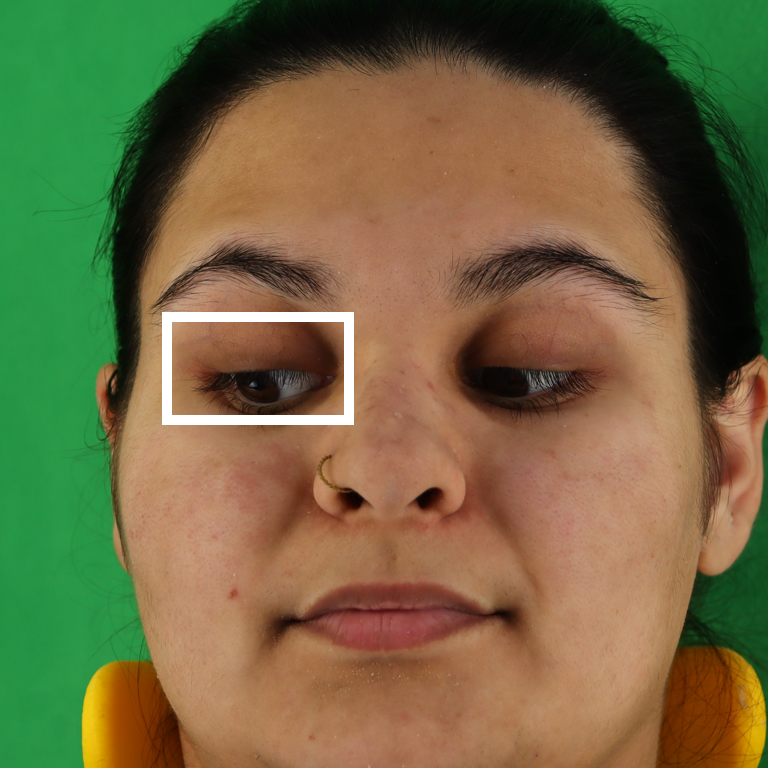

In [183]:
rect = img_resize.copy()
rect_d = ImageDraw.Draw(rect)
rect_d.rectangle(
    square, outline=(255, 255, 255), width=10
)
rect

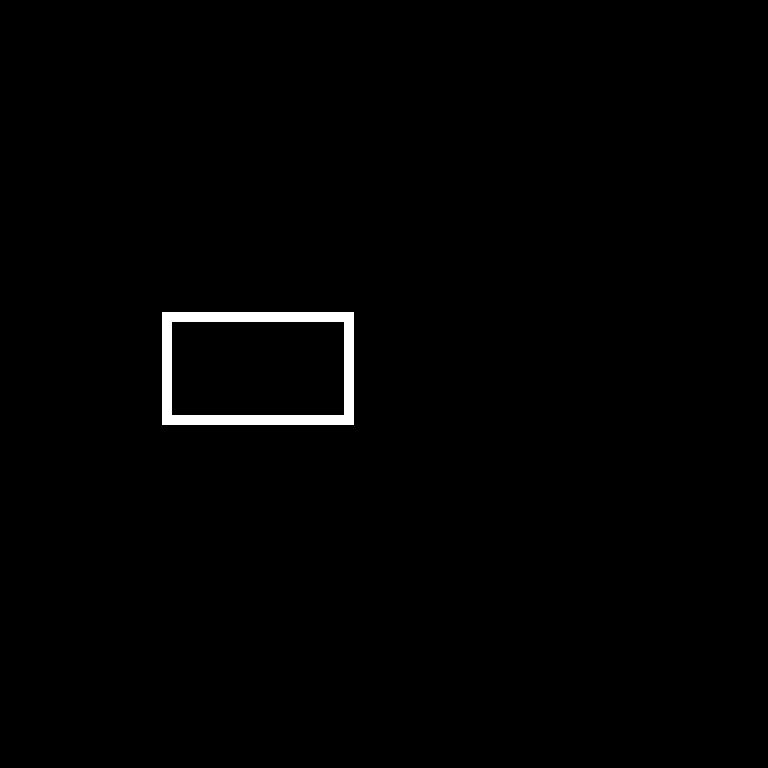

In [202]:
mask = Image.new("RGB", img_size_resized, (0, 0, 0))
rect_d = ImageDraw.Draw(mask)
rect_d.rectangle(
    square, outline=(255, 255, 255), width=10
)
mask

In [171]:
np.array(mask)[0][0]

array([0, 0, 0], dtype=uint8)

In [172]:
import sys
import cv2
import torch
import numpy as np
from PIL import Image
from omegaconf import OmegaConf
from einops import repeat
from imwatermark import WatermarkEncoder

from ldm.models.diffusion.ddim import DDIMSampler
from ldm.util import instantiate_from_config

In [200]:
torch.set_grad_enabled(False)


def put_watermark(img, wm_encoder=None):
    if wm_encoder is not None:
        img = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
        img = wm_encoder.encode(img, 'dwtDct')
        img = Image.fromarray(img[:, :, ::-1])
    return img


def initialize_model(config, ckpt):
    config = OmegaConf.load(config)
    model = instantiate_from_config(config.model)

    model.load_state_dict(torch.load(ckpt)["state_dict"], strict=False)

    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    model = model.to(device)
    sampler = DDIMSampler(model)

    return sampler


def make_batch_sd(
        image,
        mask,
        txt,
        device,
        num_samples=1):
    image = np.array(image.convert("RGB"))
    image = image[None].transpose(0, 3, 1, 2)
    image = torch.from_numpy(image).to(dtype=torch.float32) / 127.5 - 1.0

    mask = np.array(mask.convert("L"))
    mask = mask.astype(np.float32) / 255.0
    mask = mask[None, None]
    mask[mask < 0.5] = 0
    mask[mask >= 0.5] = 1
    mask = torch.from_numpy(mask)

    masked_image = image * (mask < 0.5)

    batch = {
        "image": repeat(image.to(device=device), "1 ... -> n ...", n=num_samples),
        "txt": num_samples * [txt],
        "mask": repeat(mask.to(device=device), "1 ... -> n ...", n=num_samples),
        "masked_image": repeat(masked_image.to(device=device), "1 ... -> n ...", n=num_samples),
    }
    return batch


def inpaint(sampler, image, mask, prompt, seed, scale, ddim_steps, num_samples=1, w=512, h=512, eta=1.):
    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    model = sampler.model

    print("Creating invisible watermark encoder (see https://github.com/ShieldMnt/invisible-watermark)...")
    wm = "SDV2"
    wm_encoder = WatermarkEncoder()
    wm_encoder.set_watermark('bytes', wm.encode('utf-8'))

    prng = np.random.RandomState(seed)
    start_code = prng.randn(num_samples, 4, h // 8, w // 8)
    start_code = torch.from_numpy(start_code).to(device=device, dtype=torch.float32)

    with torch.no_grad(), \
            torch.autocast("cuda"):
            batch = make_batch_sd(image, mask, txt=prompt, device=device, num_samples=num_samples)

            c = model.cond_stage_model.encode(batch["txt"])

            c_cat = list()
            for ck in model.concat_keys:
                cc = batch[ck].float()
                if ck != model.masked_image_key:
                    bchw = [num_samples, 4, h // 8, w // 8]
                    cc = torch.nn.functional.interpolate(cc, size=bchw[-2:])
                else:
                    cc = model.get_first_stage_encoding(model.encode_first_stage(cc))
                c_cat.append(cc)
            c_cat = torch.cat(c_cat, dim=1)

            # cond
            cond = {"c_concat": [c_cat], "c_crossattn": [c]}

            # uncond cond
            uc_cross = model.get_unconditional_conditioning(num_samples, "")
            uc_full = {"c_concat": [c_cat], "c_crossattn": [uc_cross]}

            shape = [model.channels, h // 8, w // 8]
            samples_cfg, intermediates = sampler.sample(
                ddim_steps,
                num_samples,
                shape,
                cond,
                verbose=False,
                eta=eta,
                unconditional_guidance_scale=scale,
                unconditional_conditioning=uc_full,
                x_T=start_code,
            )
            x_samples_ddim = model.decode_first_stage(samples_cfg)

            result = torch.clamp((x_samples_ddim + 1.0) / 2.0,
                                 min=0.0, max=1.0)

            result = result.cpu().numpy().transpose(0, 2, 3, 1) * 255
    return [put_watermark(Image.fromarray(img.astype(np.uint8)), wm_encoder) for img in result]

In [174]:
sampler = initialize_model('stablediffusion/configs/stable-diffusion/v2-inpainting-inference.yaml','stablediffusion/512-inpainting-ema.ckpt')

LatentInpaintDiffusion: Running in eps-prediction mode
DiffusionWrapper has 865.93 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels


INFO:root:Loaded ViT-H-14 model config.
2022-12-21 09:54:26.508 Loaded ViT-H-14 model config.
INFO:root:Loading pretrained ViT-H-14 weights (laion2b_s32b_b79k).
2022-12-21 09:54:34.817 Loading pretrained ViT-H-14 weights (laion2b_s32b_b79k).


In [203]:
image = img_generated
w, h = image.size
print(f"loaded input image of size ({w}, {h})")
width, height = map(lambda x: x - x % 64, (w, h))  # resize to integer multiple of 32
image = image.resize((width, height))

prompt = st.text_input("Prompt")

seed = st.number_input("Seed", min_value=0, max_value=1000000, value=0)
num_samples = st.number_input("Number of Samples", min_value=1, max_value=64, value=1)
scale = st.slider("Scale", min_value=0.1, max_value=30.0, value=10., step=0.1)
ddim_steps = st.slider("DDIM Steps", min_value=0, max_value=50, value=50, step=1)
eta = st.sidebar.number_input("eta (DDIM)", value=0., min_value=0., max_value=1.)


seed = 0
#num_samples = st.number_input("Number of Samples", min_value=1, max_value=64, value=1)
num_samples = 1
#scale = st.slider("Scale", min_value=0.1, max_value=30.0, value=10., step=0.1)
scale = 10
#ddim_steps = st.slider("DDIM Steps", min_value=0, max_value=50, value=50, step=1)
ddim_steps = 50
#eta = st.sidebar.number_input("eta (DDIM)", value=0., min_value=0., max_value=1.)
eta = 0

mask = np.array(mask)
mask = mask[:, :, -1] > 0
if mask.sum() > 0:
    mask = Image.fromarray(mask)

    result = inpaint(
        sampler=sampler,
        image=image,
        mask=mask,
        prompt=prompt,
        seed=seed,
        scale=scale,
        ddim_steps=ddim_steps,
        num_samples=num_samples,
        h=height, w=width, eta=eta
    )

loaded input image of size (768, 768)
Creating invisible watermark encoder (see https://github.com/ShieldMnt/invisible-watermark)...
Data shape for DDIM sampling is (1, 4, 96, 96), eta 0
Running DDIM Sampling with 50 timesteps


DDIM Sampler: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:11<00:00,  4.19it/s]


In [205]:
img_generated_final = result[0]

In [207]:
img_generated_final = img_generated_final.resize(crop_size)

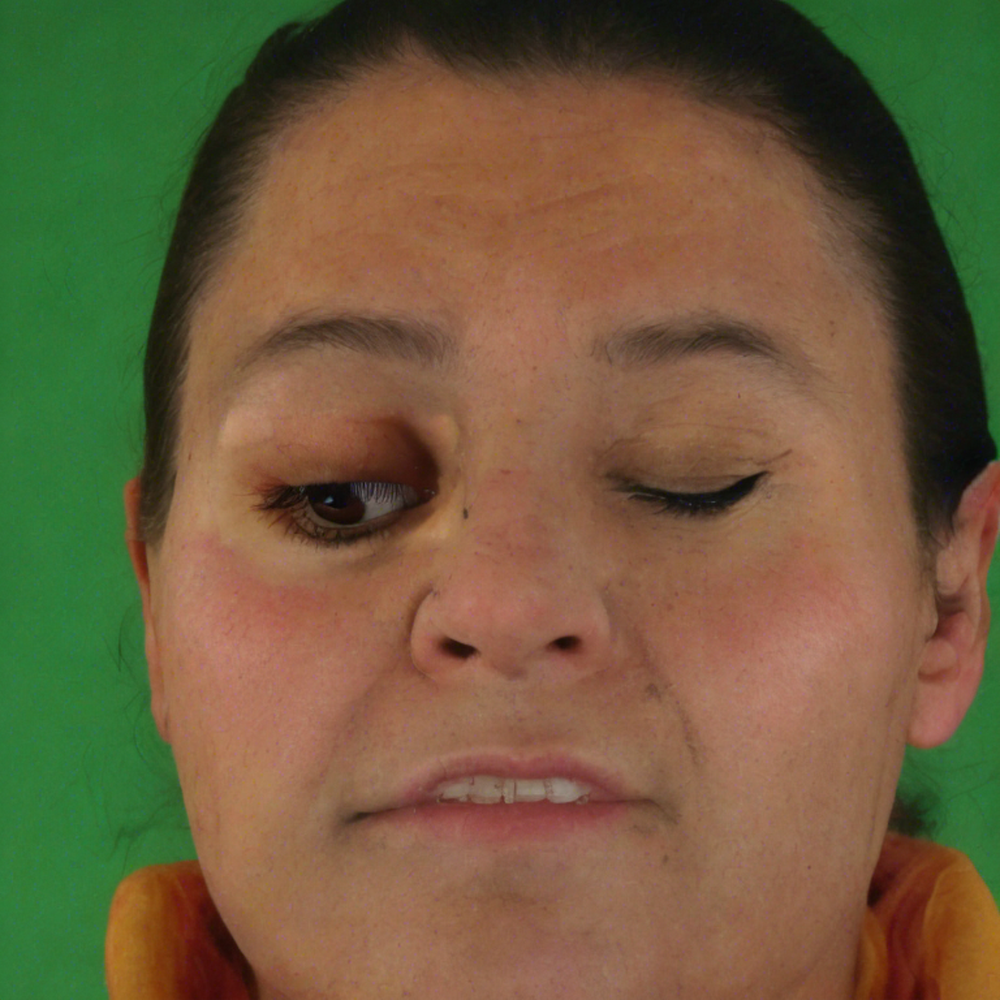

In [208]:
img_generated_final

In [209]:
raw_image_generated = img.copy()

In [210]:
raw_image_generated.paste(img_generated_final, upper_left)

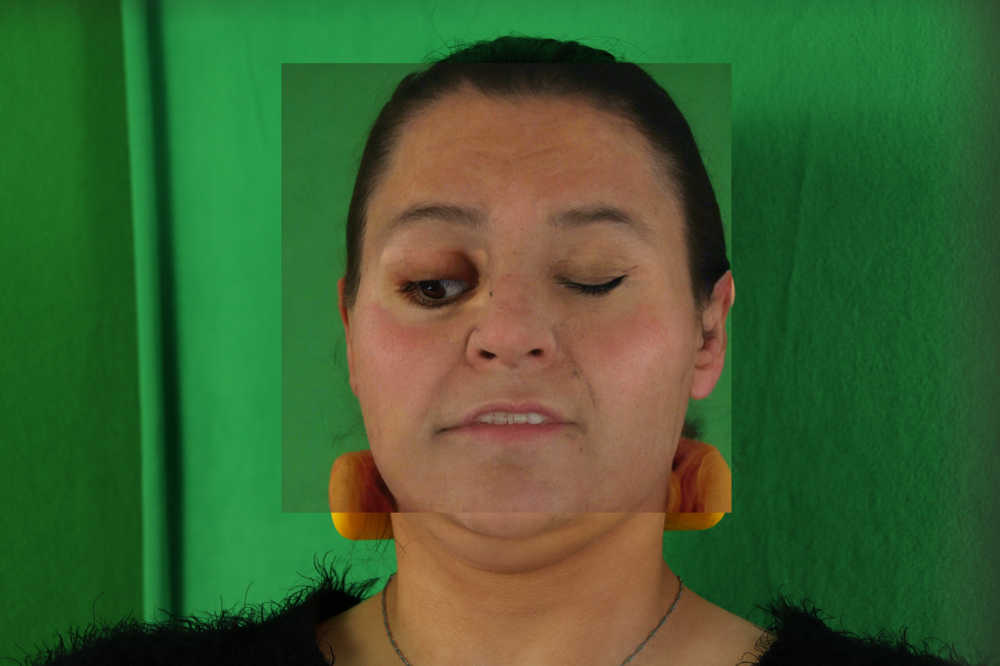

In [211]:
raw_image_generated